In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
sns.set_style("darkgrid")
import altair as alt

In [22]:
# load the data into a dataframe
df = pd.read_csv("diamonds.csv")

print(df.head())

   Unnamed: 0  carat      cut color clarity  depth  table  price     x     y  \
0           1   0.23    Ideal     E     SI2   61.5   55.0    326  3.95  3.98   
1           2   0.21  Premium     E     SI1   59.8   61.0    326  3.89  3.84   
2           3   0.23     Good     E     VS1   56.9   65.0    327  4.05  4.07   
3           4   0.29  Premium     I     VS2   62.4   58.0    334  4.20  4.23   
4           5   0.31     Good     J     SI2   63.3   58.0    335  4.34  4.35   

      z  
0  2.43  
1  2.31  
2  2.31  
3  2.63  
4  2.75  


In [23]:
# Create a new column 'price_level' that categorizes price into 4 levels
# We'll use pandas qcut to divide price into 4 quantile-based bins
df['price_level'] = pd.qcut(df['price'], q=4, labels=['Low', 'Medium', 'High', 'Very High'])

# Display the updated DataFrame with the new column
df[['price', 'price_level']].head()

,price,price_level
0,326,Low
1,326,Low
2,327,Low
3,334,Low
4,335,Low


In [24]:
# Group by cut and color, then calculate the average price
color_df = df.groupby(['cut', 'color'])['price'].mean().reset_index()

# round the average likes to 2 decimal places
color_df['price'] = color_df['price'].round(2)

# Rename the column for clarity
color_df.rename(columns={'price': 'average_price'}, inplace=True)

color_df.head()


,cut,color,average_price
0,Fair,D,4291.06
1,Fair,E,3682.31
2,Fair,F,3827.00
3,Fair,G,4239.25
4,Fair,H,5135.68


In [25]:
# Define the desired order for cut and color
cut_order = ['Fair', 'Good', 'Very Good', 'Premium', 'Ideal']
color_order = ['J', 'I', 'H', 'G', 'F', 'E', 'D']
clarity_order = ['I1', 'SI2', 'SI1', 'VS2', 'VS1', 'VVS2', 'VVS1', 'IF']

# Convert 'cut' and 'color' columns to categorical with the specified order
color_df['cut'] = pd.Categorical(color_df['cut'], categories=cut_order, ordered=True)
color_df['color'] = pd.Categorical(color_df['color'], categories=color_order, ordered=True)

# Sort the DataFrame
sorted_color_df = color_df.sort_values(by=['cut', 'color']).reset_index(drop=True)

# save the data to a CSV file
file_path = "colorPriceAvg.csv"
sorted_color_df.to_csv(file_path, index=False)

In [26]:
# Group by cut and color, then calculate the average price
clarity_df = df.groupby(['cut', 'clarity'])['price'].mean().reset_index()

# round the average likes to 2 decimal places
clarity_df['price'] = clarity_df['price'].round(2)

# Rename the column for clarity
clarity_df.rename(columns={'price': 'average_price'}, inplace=True)

clarity_df.head()

,cut,clarity,average_price
0,Fair,I1,3703.53
1,Fair,IF,1912.33
2,Fair,SI1,4208.28
3,Fair,SI2,5173.92
4,Fair,VS1,4165.14


In [27]:
clarity_order = ['I1', 'SI2', 'SI1', 'VS2', 'VS1', 'VVS2', 'VVS1', 'IF']

# Convert 'cut' and 'color' columns to categorical with the specified order
clarity_df['cut'] = pd.Categorical(clarity_df['cut'], categories=cut_order, ordered=True)
clarity_df['clarity'] = pd.Categorical(clarity_df['clarity'], categories=clarity_order, ordered=True)

# Sort the DataFrame
sorted_clarity_df = clarity_df.sort_values(by=['cut', 'clarity']).reset_index(drop=True)

# save the data to a CSV file
file_path = "clarityPriceAvg.csv"
sorted_clarity_df.to_csv(file_path, index=False)

In [28]:
# select two numerical variables: 'carat' and 'price'
selected_columns = ['carat', 'price']

# get statistical summary
stats_summary = df[selected_columns].describe()
print(round(stats_summary,3))

           carat     price
count  53940.000  53940.00
mean       0.798   3932.80
std        0.474   3989.44
min        0.200    326.00
25%        0.400    950.00
50%        0.700   2401.00
75%        1.040   5324.25
max        5.010  18823.00


In [29]:
numerical_variables = ['price', 'carat', 'depth', 'table', 'x', 'y', 'z']
numerical_df = df[numerical_variables]
numerical_df.head()

,price,carat,depth,table,x,y,z
0,326,0.23,61.5,55.0,3.95,3.98,2.43
1,326,0.21,59.8,61.0,3.89,3.84,2.31
2,327,0.23,56.9,65.0,4.05,4.07,2.31
3,334,0.29,62.4,58.0,4.20,4.23,2.63
4,335,0.31,63.3,58.0,4.34,4.35,2.75


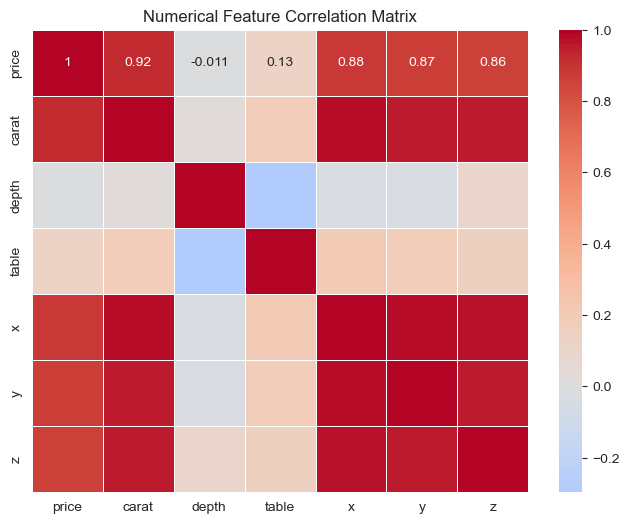

In [46]:
# compute the correlation matrix
corr_matrix = numerical_df.corr()

# create a heatmap to visualize the correlation matrix
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5, center=0)
plt.title("Numerical Feature Correlation Matrix")
plt.savefig("correlation_matrix.png", dpi=300, bbox_inches='tight')
plt.show()

The correlation matrix heatmap provides insight into the relationships between the numerical features in the diamonds dataset. One of the most prominent patterns is the strong positive correlation between carat and price (0.92), indicating that as the weight of a diamond increases, its price tends to rise significantly. Additionally, the physical dimensions of the diamond—represented by x (length), y (width), and z (depth in mm)—are also strongly correlated with both carat and price, with correlation coefficients ranging from 0.86 to 0.98. These variables tend to increase together, suggesting that larger diamonds in physical size are not only heavier but also more expensive. However, since x, y, and z are highly correlated with each other, including all of them in further analysis may introduce multicollinearity. It would be more efficient to select just one of these, or rely on carat alone as it already encapsulates size.

On the other hand, depth and table show weak correlations with price and other variables. Depth, in particular, has near-zero correlation with price (-0.011) and negligible relationships with other features, making it a poor predictor. Table has a slightly higher correlation with price (0.13), but still too weak to be considered influential. Interestingly, there is a modest negative correlation between depth and table (-0.3), which might reflect a trade-off in diamond geometry. Based on these observations, the most valuable variables for further analysis are carat, and  the physical dimensions (x, y, and z) are better to discuss together, and categorical features such as cut, color, and clarity, which are not included in the heatmap but are likely important for predicting price. Depth and table may be excluded from further analysis due to their weak associations.

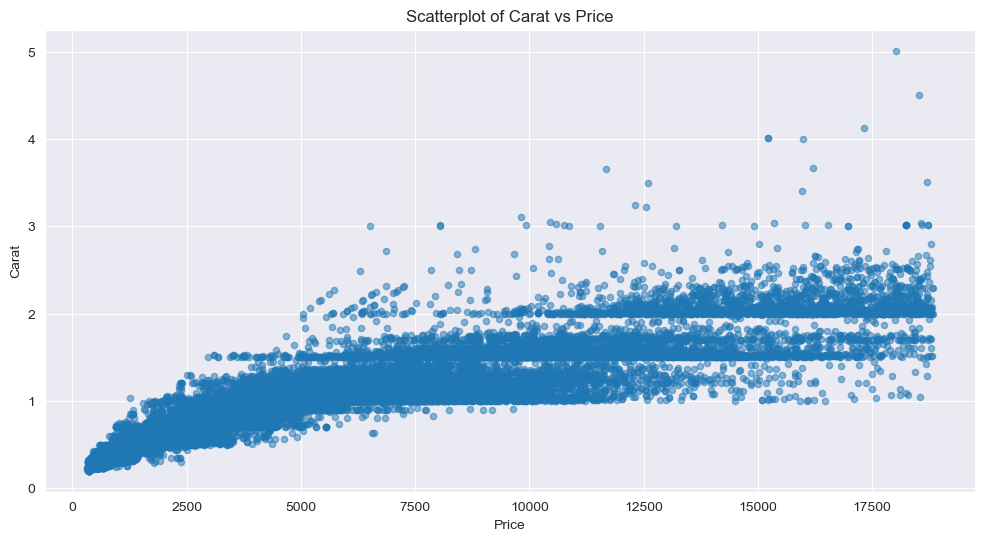

In [31]:
# create a scatter plot for carat vs price
plt.figure(figsize=(12, 6))
plt.scatter(df['price'], df['carat'], s=20, alpha=0.5)
plt.xlabel("Price")
plt.ylabel("Carat")
plt.title("Scatterplot of Carat vs Price")
plt.show()

In [32]:
# create a list of color 
legend_color = ['#a8cdb0', '#5e9c6f', '#2f7042', '#1f5a2f', '#0f3f1f', '#001a0d']

In [33]:
# disable max row limit in chart rendering
alt.data_transformers.disable_max_rows()

# cut dropdown setup
cut_options = sorted(df['cut'].unique().tolist())
input_dropdown = alt.binding_radio(
    options=[None] + cut_options,
    labels=['All'] + cut_options,
    name='Cut: '
)
selection = alt.selection_point(fields = ['cut'], bind = input_dropdown)

# clarity dropdown setup
clarity_options = sorted(df['clarity'].unique().tolist())
input_dropdown = alt.binding_radio(
    options=[None] + clarity_options,
    labels=['All'] + clarity_options,
    name='Clarity: '
)
clarity_selection = alt.selection_point(fields = ['clarity'], bind = input_dropdown)

# plot the chart
b=alt.Chart(df).mark_circle().encode(
    x=alt.X('price:Q', title='Price'),
    y=alt.Y('carat:Q', title='Carat'),  
    color = alt.condition(selection, 
                          alt.Color('cut:N', scale=alt.Scale(range=legend_color), legend=alt.Legend(title='Cut')), 
                          alt.value('lightgrey')),
    opacity=alt.condition(selection, alt.value(1), alt.value(0)),
).add_params(
    selection, 
).properties(
    width=600,
    height=400,
    title="The Relationship bewtween Price and Carat"
)
b

/opt/anaconda3/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [34]:
b.save('scatter_price_carat_cut.html')

/opt/anaconda3/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


In [35]:
# disable row limit for large datasets
alt.data_transformers.disable_max_rows()

# dropdown for 'cut'
cut_order = ['Fair', 'Good', 'Very Good', 'Premium', 'Ideal']
cut_options = cut_order
cut_dropdown = alt.binding_radio(
    options=[None] + cut_options,
    labels=['All'] + cut_options,
    name='Cut: '
)
cut_selection = alt.selection_point(fields=['cut'], bind=cut_dropdown)

# dropdown for 'clarity'
clarity_order = ['I1', 'SI2', 'SI1', 'VS2', 'VS1', 'VVS2', 'VVS1', 'IF']
clarity_options = clarity_order
clarity_dropdown = alt.binding_radio(
    options=[None] + clarity_options,
    labels=['All'] + clarity_options,
    name='Clarity: '
)
clarity_selection = alt.selection_point(fields=['clarity'], bind=clarity_dropdown)

# dropdown for 'color'
color_order = ['J', 'I', 'H', 'G', 'F', 'E', 'D']
color_options = color_order
color_dropdown = alt.binding_radio(
    options=[None] + color_options,
    labels=['All'] + color_options,
    name='Color: '
)
color_selection = alt.selection_point(fields=['color'], bind=color_dropdown)

# base scatter plot
scatter = alt.Chart(df).mark_circle().encode(
    x=alt.X('carat:Q', title='Carat'),
    y=alt.Y('price:Q', title='Price'),  
    color=alt.condition(
        cut_selection,
        alt.Color('cut:N', scale=alt.Scale(domain=cut_order, range=legend_color), legend=alt.Legend(title='Cut')),
        alt.value('lightgrey')
    ),
    opacity=alt.condition(cut_selection, alt.value(1), alt.value(0)),
).add_params(
    cut_selection,
    clarity_selection,
    color_selection
).transform_filter(
    clarity_selection & color_selection
).properties(
    width=600,
    height=400,
    title="The Relationship between Price and Carat"
)

# regression line
regression = alt.Chart(df).transform_filter(
    cut_selection & clarity_selection & color_selection
).transform_regression(
    'carat', 'price', method='poly'
).mark_line(color='red', strokeDash=[5, 5]).encode(
    x='carat:Q',
    y='price:Q'
)

# combine chart and regression line
final = scatter + regression

final

/opt/anaconda3/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [36]:
final.save('scatter_price_carat.html')

/opt/anaconda3/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


General Pattern: All Cuts Combined

In the first scatter plot that includes all cuts, we observe a clear positive correlation between carat and price: as the carat of a diamond increases, its price tends to rise. However, this relationship is nonlinear—prices grow faster at higher carats, suggesting that price increases exponentially with carat size. There's a dense concentration of diamonds under 2 carats and $6,000, indicating these are the most common and accessible options. Above 2 carats, diamonds become much rarer and significantly more expensive. Additionally, we see overlapping dots from different cuts, indicating that cut alone doesn't solely determine price—other factors like color and clarity may play a role.

Individual Cut Trends

- Fair Cut
Diamonds with a Fair cut tend to have greater variation in price for the same carat weight. Some Fair cut diamonds with high carat values exceed $15,000, while others of similar weight are significantly less expensive. This suggests inconsistency, potentially due to lower perceived quality or trade-offs in other attributes like clarity or color.

- Good Cut
Good cut diamonds display a moderate upward trend. Most diamonds in this category fall below 2 carats and $10,000. There is more price consistency than Fair cut diamonds, suggesting slightly better overall quality, but still notable variability.

- Very Good Cut
Diamonds with a Very Good cut show a tighter and more consistent relationship between carat and price. Prices rise steadily with carat weight, and the spread is narrower compared to Fair and Good cuts. Most diamonds are under 2.5 carats and $12,000, indicating popularity among buyers seeking balance between quality and price.

- Ideal Cut
Ideal cut diamonds are concentrated in the lower carat range (below 2 carats) with prices mostly under $10,000. This could reflect market preference for Ideal cuts in smaller, well-proportioned stones. The price-to-carat trend is consistent, though not as steep as Premium cuts. These diamonds tend to offer high quality at more modest sizes.

- Premium Cut
Premium cut diamonds demonstrate one of the clearest and strongest upward trends. There are many high-carat diamonds in this group, with prices stretching well past $15,000. This indicates that Premium cuts are often chosen for larger, more luxurious diamonds and that the market places higher value on this combination.

Summary of Price Relationship

Across all charts, the strongest factor influencing price is carat, with price rising as carat increases, especially beyond the 2-carat mark. However, cut also plays a role: Premium and Very Good cuts tend to have higher price ranges at similar carats, while Ideal cuts are more concentrated in smaller diamonds. Fair cuts show the most price variability, possibly reflecting inconsistencies in quality or market value. These scatter plots confirm the finding from the correlation matrix that carat is the most powerful predictor of diamond price, but also suggest that cut quality interacts with carat to shape the final price.

In [37]:
# create an interval selection for price 
price_selection = alt.selection_interval(encodings=['x'])

# build the chart
base = alt.Chart(df).mark_circle().encode(
    x = 'price:Q',
    y = 'carat:Q', 
    color = alt.condition(price_selection, 
                          alt.Color('cut:N', scale=alt.Scale(range=legend_color), legend=alt.Legend(title='Cut')), 
                          alt.value('lightgrey')),
    opacity=alt.condition(price_selection, alt.value(1), alt.value(0.1)),
).add_params(
    price_selection, 
).properties(
    width=600,
    height=400,
)
base

/opt/anaconda3/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [38]:
# create histograms for x, y, and z dimensions
hist_x = alt.Chart(df).mark_bar().encode(
    alt.X('x:Q', bin=alt.Bin(maxbins=50), title='x dimension'),
    y=alt.Y('count()', title='Frequency'),
    color=alt.value('#1f77b4'),
    tooltip=['count()']
).transform_filter(
    price_selection
)

hist_y = alt.Chart(df).mark_bar().encode(
    alt.X('y:Q', bin=alt.Bin(maxbins=50), title='y dimension'),
    y=alt.Y('count()', title='Frequency'),
    color=alt.value('#ff7f0e'),
    tooltip=['count()']
).transform_filter(
    price_selection
)

hist_z = alt.Chart(df).mark_bar().encode(
    alt.X('z:Q', bin=alt.Bin(maxbins=50), title='z dimension'),
    y=alt.Y('count()', title='Frequency'),
    color=alt.value('#67000d'),
    tooltip=['count()']
).transform_filter(
    price_selection
)

# combine all plots with the base
m = alt.vconcat(
    base,
    alt.hconcat(hist_x, hist_y, hist_z)
).resolve_scale(
    y='independent'
)

m

/opt/anaconda3/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.VConcatChart(...)

Relationship Between Price and Dimensions

The scatter plot in the top-left corner of the first image shows a strong positive relationship between carat and price, consistent with earlier findings. However, since carat is derived from the diamond's volume, it's closely tied to the dimensions x, y, and z. This implies that as x, y, and z increase, carat and therefore price also tend to increase. We see that diamonds with larger dimensions often fall into higher price ranges, but the relationship becomes more dispersed at higher prices, suggesting that other factors (like cut and clarity) also contribute to the final value.

- x-Dimension (Length) Patterns
Across all price ranges, the x dimension is typically between 4 mm and 8 mm, peaking around 5–6.5 mm. Lower-priced diamonds (under 4,000) tend to have smaller x-values, often below 6 mm, while higher-priced diamonds frequently exceed 6 mm in length. As price increases, the frequency of x-values also shifts to the right, with higher-priced diamonds having larger lengths. In the highest price range (above $16,000), x-dimensions are frequently above 8 mm, indicating that longer diamonds contribute to premium pricing.

- y-Dimension (Width) Patterns
The y dimension follows a similar distribution to x. For most diamonds, y ranges from 4 mm to 8 mm, with a concentration between 5.5 and 7.5 mm. In lower price ranges, y dimensions are more concentrated at the lower end (around 5–6 mm), while in higher price brackets, y spreads out towards 8 mm and beyond. In the highest price segment, y-dimension values approach or exceed 9 mm, reinforcing the pattern that physically larger diamonds fetch higher prices.

- z-Dimension (Depth) Patterns
The z dimension also reflects a consistent trend: as price increases, so does z. For most diamonds, z ranges from 2 mm to 5.5 mm, with peaks around 3.5–4.5 mm. High-priced diamonds typically have a z-dimension closer to 5 mm or above, suggesting greater depth. However, z shows a slightly narrower spread than x and y, likely due to tighter tolerances in cut quality and proportions required for optimal brilliance.

Conclusion

The physical dimensions x, y, and z are highly correlated with carat and therefore with price. As these dimensions increase, so does the price of the diamond. Among them, the x and y dimensions (length and width) show the most noticeable spread across price categories, making them good indicators of size and price potential. While z (depth) also increases with price, its tighter distribution reflects stricter design constraints. Overall, the relationship between diamond price and size is both strong and nonlinear, and x, y, z offer useful predictive insights when assessing diamond value.

In [39]:
m.save('x_y_z.html')

/opt/anaconda3/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


In [40]:
import pandas as pd
import plotly.graph_objects as go
import plotly.colors as pc

# assign consistent base colors to each group: Cut, Clarity, Color
base_colors = {
    'cut': 'Greens',
    'clarity': 'Purples',
    'color': 'Reds'
}

# define label orders
cut_order = ['Fair', 'Good', 'Very Good', 'Premium', 'Ideal']
clarity_order = ['I1', 'SI2', 'SI1', 'VS2', 'VS1', 'VVS2', 'VVS1', 'IF']
color_order = ['J', 'I', 'H', 'G', 'F', 'E', 'D']

# create full label list and mapping
labels = cut_order + clarity_order + color_order
label_to_index = {label: idx for idx, label in enumerate(labels)}

# create the colors
cut_colors = ['#a8cdb0', '#5e9c6f', '#2f7042', '#1f5a2f', '#0f3f1f', '#001a0d'][:len(cut_order)]
clarity_colors = ['#c0a2e4', '#aa89db', '#9670d2', '#8155c7','#6e3fb5','#5a2a91','#47126b', '#2e004d'][:len(clarity_order)]
color_colors = ['#fcbba1','#fc9272','#fb6a4a','#ef3b2c','#cb181d','#a50f15','#67000d'][:len(color_order)]

# combine the colors 
node_colors = cut_colors + clarity_colors + color_colors

# label the colors
labels = cut_order + clarity_order + color_order
label_to_index = {label: idx for idx, label in enumerate(labels)}
label_to_color = dict(zip(labels, node_colors))

# Group and count data for links
cut_clarity = df.groupby(['cut', 'clarity']).size().reset_index(name='count')
clarity_color = df.groupby(['clarity', 'color']).size().reset_index(name='count')

# create links: Cut → Clarity
cut_to_clarity = {
    'source': [label_to_index[row['cut']] for _, row in cut_clarity.iterrows()],
    'target': [label_to_index[row['clarity']] for _, row in cut_clarity.iterrows()],
    'value': cut_clarity['count'].tolist(),
    'color': [label_to_color[row['cut']] for _, row in cut_clarity.iterrows()]  # link color same as source node
}

# create links: Clarity → Color
clarity_to_color = {
    'source': [label_to_index[row['clarity']] for _, row in clarity_color.iterrows()],
    'target': [label_to_index[row['color']] for _, row in clarity_color.iterrows()],
    'value': clarity_color['count'].tolist(),
    'color': [label_to_color[row['clarity']] for _, row in clarity_color.iterrows()]
}

# combine all links
sources = cut_to_clarity['source'] + clarity_to_color['source']
targets = cut_to_clarity['target'] + clarity_to_color['target']
values = cut_to_clarity['value'] + clarity_to_color['value']
link_colors = cut_to_clarity['color'] + clarity_to_color['color']

# create Sankey diagram
fig = go.Figure(data=[go.Sankey(
    arrangement="snap",  # Enables dragging
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=labels,
        color=node_colors
    ),
    link=dict(
        source=sources,
        target=targets,
        value=values,
        color=link_colors
    )
)])

fig.update_layout(
    title_text="Sankey Diagram: Cut vs. Clarity vs. Color",
    font_size=12,
    width=1000,  
    height=600 
)
fig.show()


In [41]:
fig.write_html("sankey.html")